# Data Processing

In [1]:
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
df = pd.read_csv(r'crime.csv')

In [3]:
df.head(4)

,INCIDENT_ID,OFFENSE_ID,OFFENSE_CODE,OFFENSE_CODE_EXTENSION,OFFENSE_TYPE_ID,OFFENSE_CATEGORY_ID,FIRST_OCCURRENCE_DATE,LAST_OCCURRENCE_DATE,REPORTED_DATE,INCIDENT_ADDRESS,GEO_X,GEO_Y,GEO_LON,GEO_LAT,DISTRICT_ID,PRECINCT_ID,NEIGHBORHOOD_ID,IS_CRIME,IS_TRAFFIC
0,2021224206,2021224206220200,2202,0,burglary-residence-by-force,burglary,4/18/2021 10:30:00 PM,4/19/2021 5:00:00 AM,4/21/2021 3:25:00 PM,300 W 11TH AVE,3142828.0,1692472.0,-104.992161,39.733543,6.0,611.0,civic-center,1,0
1,2021225308,2021225308240400,2404,0,theft-of-motor-vehicle,auto-theft,4/21/2021 11:25:00 PM,NaN,4/22/2021 12:01:00 AM,5700 BLK W DARTMOUTH AVE,3124936.0,1664570.0,-105.056261,39.657203,4.0,423.0,bear-valley,1,0
2,20216009452,20216009452239900,2399,0,theft-other,larceny,3/22/2021 12:51:00 PM,3/22/2021 12:51:00 PM,4/21/2021 10:13:00 PM,3412 N HUMBOLDT ST,3149191.0,1703917.0,-104.969299,39.764862,2.0,211.0,cole,1,0
3,20216009439,20216009439230500,2305,0,theft-items-from-vehicle,theft-from-motor-vehicle,4/21/2021 12:00:00 PM,4/21/2021 12:05:00 PM,4/21/2021 1:17:00 PM,1900 BLK S CLARKSON ST,3146781.0,1673727.0,-104.978488,39.682023,3.0,313.0,platt-park,1,0


In [4]:
pd.set_option('display.max_columns',None)

In [5]:
df.isnull().any().any()

True

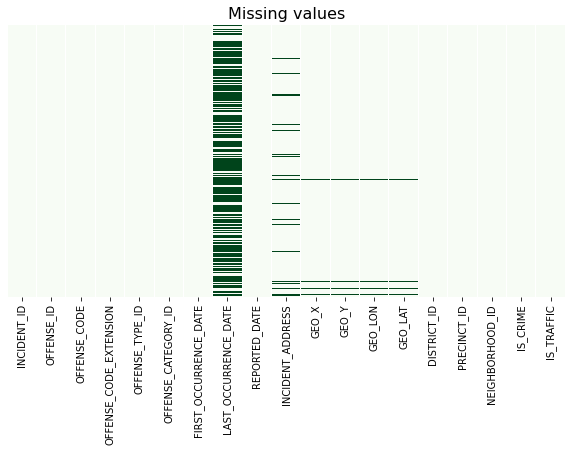

In [6]:
plt.figure(figsize=(10,5))
sns.heatmap(df.isnull(),yticklabels=False, cbar=False ,cmap='Greens')
plt.title('Missing values',size=16)
plt.show()

In [7]:
df.isnull().sum()

INCIDENT_ID                    0
OFFENSE_ID                     0
OFFENSE_CODE                   0
OFFENSE_CODE_EXTENSION         0
OFFENSE_TYPE_ID                0
OFFENSE_CATEGORY_ID            0
FIRST_OCCURRENCE_DATE          0
LAST_OCCURRENCE_DATE      337432
REPORTED_DATE                  0
INCIDENT_ADDRESS           44334
GEO_X                       4455
GEO_Y                       4455
GEO_LON                     4456
GEO_LAT                     4456
DISTRICT_ID                    1
PRECINCT_ID                    1
NEIGHBORHOOD_ID                1
IS_CRIME                       0
IS_TRAFFIC                     0
dtype: int64

In [8]:
df = df.dropna(subset=['GEO_LON'])
df.isnull().sum()

INCIDENT_ID                    0
OFFENSE_ID                     0
OFFENSE_CODE                   0
OFFENSE_CODE_EXTENSION         0
OFFENSE_TYPE_ID                0
OFFENSE_CATEGORY_ID            0
FIRST_OCCURRENCE_DATE          0
LAST_OCCURRENCE_DATE      335438
REPORTED_DATE                  0
INCIDENT_ADDRESS           39879
GEO_X                          0
GEO_Y                          0
GEO_LON                        0
GEO_LAT                        0
DISTRICT_ID                    0
PRECINCT_ID                    0
NEIGHBORHOOD_ID                0
IS_CRIME                       0
IS_TRAFFIC                     0
dtype: int64

In [9]:
int(max(df.GEO_LON))

0

In [10]:
# removing invalid data
df = df[df['GEO_LON'] < -1]

In [11]:
min(df.GEO_LAT)

34.6382357

In [12]:
df = df[df['GEO_LAT'] > 39]
df.reset_index(drop=True, inplace=True)

In [13]:
#Changing the date format and grabing the day of week from data
date_occurence = pd.to_datetime(df.FIRST_OCCURRENCE_DATE)
date_reported = pd.to_datetime(df.REPORTED_DATE)

df['FIRST_OCCURRENCE_DATE'] = date_occurence
df['REPORTED_DATE'] = date_reported

df['occurence_day_of_week'] = date_occurence.dt.dayofweek
df['reported_day_of_week'] = date_reported.dt.dayofweek

In [14]:
#Grabing the year,month,day and hour from occurence data
occurence_day = []
occurence_month = []
occurence_year = []
occurence_hour = []
for record in df.FIRST_OCCURRENCE_DATE:
    a = str(record)
    occurence_year.append(int(a[0:a.rfind('-',4,6)]))
    occurence_month.append(int(a[a.rfind('-',4,6)+1:a.rfind('-')]))
    occurence_day.append(int(a[a.rfind('-')+1:a.rfind('-')+3]))
    occurence_hour.append(int(a[a.rfind(' ')+1:a.rfind(' ')+3]))
df['occurence_day'] = occurence_day
df['occurence_month'] = occurence_month
df['occurence_year'] = occurence_year
df['occurence_hour'] = occurence_hour

In [15]:
#Grabing the year,month,day and hour from reported data
reported_year = []
reported_month = []
reported_day  = []
reported_hour = []
for record in df.REPORTED_DATE:
    a = str(record)
    reported_year.append(int(a[0:a.rfind('-',4,6)]))
    reported_month.append(int(a[a.rfind('-',4,6)+1:a.rfind('-')]))
    reported_day.append(int(a[a.rfind('-')+1:a.rfind('-')+3]))
    reported_hour.append(int(a[a.rfind(' ')+1:a.rfind(' ')+3]))
df['reported_year'] = reported_year
df['reported_month'] = reported_month
df['reported_day'] = reported_day
df['reported_hour'] = reported_hour

In [16]:
# Calculating the time gap between reported date and occurence date for each case
time_gap = []
for i in range(0,len(df)):
    a = str(df.REPORTED_DATE[i] - df.FIRST_OCCURRENCE_DATE[i])
    time_gap.append(int(a[0:a.rfind(' days')]))
df['time_gap'] = time_gap

In [17]:
df.head()

,INCIDENT_ID,OFFENSE_ID,OFFENSE_CODE,OFFENSE_CODE_EXTENSION,OFFENSE_TYPE_ID,OFFENSE_CATEGORY_ID,FIRST_OCCURRENCE_DATE,LAST_OCCURRENCE_DATE,REPORTED_DATE,INCIDENT_ADDRESS,GEO_X,GEO_Y,GEO_LON,GEO_LAT,DISTRICT_ID,PRECINCT_ID,NEIGHBORHOOD_ID,IS_CRIME,IS_TRAFFIC,occurence_day_of_week,reported_day_of_week,occurence_day,occurence_month,occurence_year,occurence_hour,reported_year,reported_month,reported_day,reported_hour,time_gap
0,2021224206,2021224206220200,2202,0,burglary-residence-by-force,burglary,2021-04-18 22:30:00,4/19/2021 5:00:00 AM,2021-04-21 15:25:00,300 W 11TH AVE,3142828.0,1692472.0,-104.992161,39.733543,6.0,611.0,civic-center,1,0,6,2,18,4,2021,22,2021,4,21,15,2
1,2021225308,2021225308240400,2404,0,theft-of-motor-vehicle,auto-theft,2021-04-21 23:25:00,NaN,2021-04-22 00:01:00,5700 BLK W DARTMOUTH AVE,3124936.0,1664570.0,-105.056261,39.657203,4.0,423.0,bear-valley,1,0,2,3,21,4,2021,23,2021,4,22,0,0
2,20216009452,20216009452239900,2399,0,theft-other,larceny,2021-03-22 12:51:00,3/22/2021 12:51:00 PM,2021-04-21 22:13:00,3412 N HUMBOLDT ST,3149191.0,1703917.0,-104.969299,39.764862,2.0,211.0,cole,1,0,0,2,22,3,2021,12,2021,4,21,22,30
3,20216009439,20216009439230500,2305,0,theft-items-from-vehicle,theft-from-motor-vehicle,2021-04-21 12:00:00,4/21/2021 12:05:00 PM,2021-04-21 13:17:00,1900 BLK S CLARKSON ST,3146781.0,1673727.0,-104.978488,39.682023,3.0,313.0,platt-park,1,0,2,2,21,4,2021,12,2021,4,21,13,0
4,20218017976,20218017976240400,2404,0,theft-of-motor-vehicle,auto-theft,2021-03-09 12:01:00,4/21/2021 12:20:00 PM,2021-04-21 12:20:00,24050 E 78TH AVE,3223419.0,1730557.0,-104.704438,39.836504,7.0,759.0,dia,1,0,1,2,9,3,2021,12,2021,4,21,12,43


# EDA

In [18]:
plt.rcParams["figure.figsize"] = (16,8)

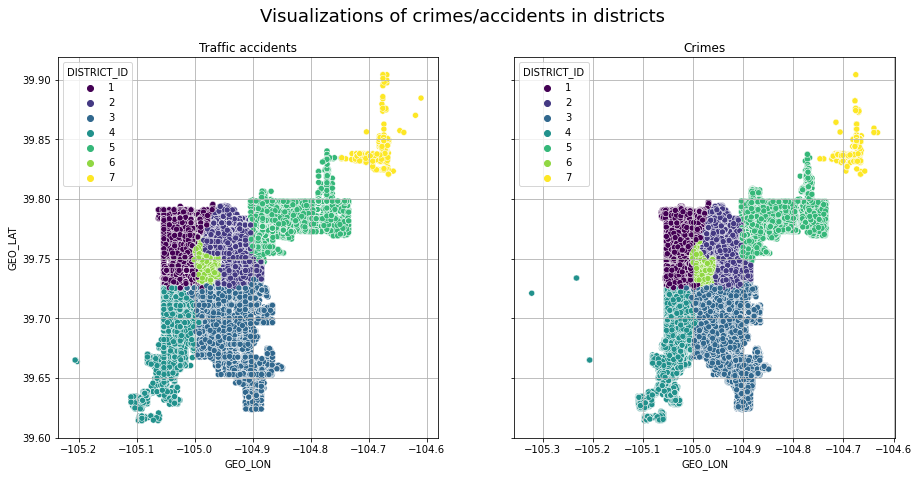

In [19]:
fig, ax = plt.subplots(nrows=1,ncols=2,sharey=True, figsize=(15,7))

sns.scatterplot(data=df.query('IS_TRAFFIC == 1'),x='GEO_LON', y='GEO_LAT', hue='DISTRICT_ID', palette='viridis', ax=ax[0],zorder=1)
sns.scatterplot(data=df.query('IS_CRIME == 1'),x='GEO_LON', y='GEO_LAT', hue='DISTRICT_ID', palette='viridis', ax=ax[1],zorder=1)

fig.suptitle('Visualizations of crimes/accidents in districts',size=18)

ax[0].title.set_text('Traffic accidents')
ax[0].grid(zorder=3)

ax[1].title.set_text('Crimes')
ax[1].grid(zorder=3)

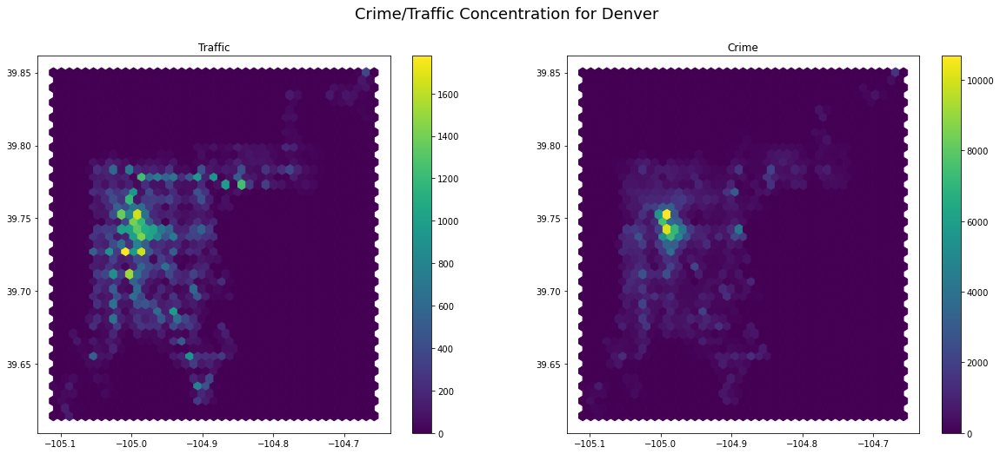

In [20]:
data1 = df.query('IS_TRAFFIC == 1').loc[(df.GEO_LON >=-105.15) & (df.GEO_LAT <=39.85)]
data2 = df.query('IS_TRAFFIC == 0').loc[(df.GEO_LON >=-105.15) & (df.GEO_LAT <=39.85)]

fig, axs = plt.subplots(ncols=2, figsize=(20, 8))

fig.suptitle('Crime/Traffic Concentration for Denver',size=18)
ax = axs[0]
hb = ax.hexbin(data1.GEO_LON,data1.GEO_LAT, gridsize=40)

ax.set_title("Traffic")
fig.colorbar(hb, ax=ax)

ax = axs[1]
hb = ax.hexbin(data2.GEO_LON,data2.GEO_LAT, gridsize=40)

ax.set_title("Crime")
fig.colorbar(hb, ax=ax)

plt.show()

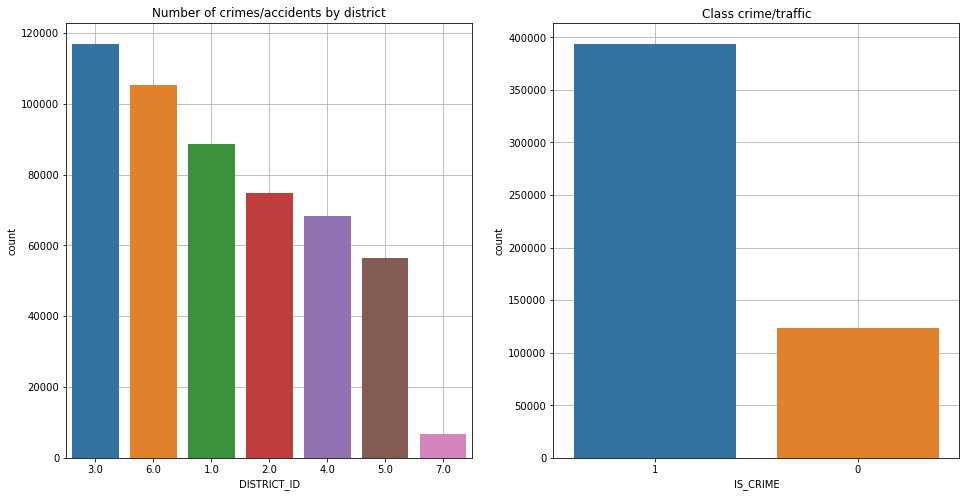

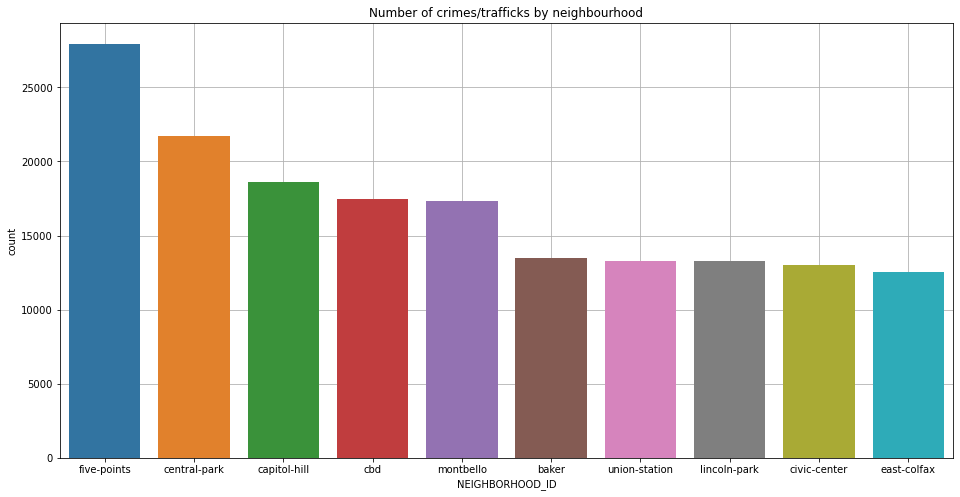

In [21]:
fig, ax = plt.subplots(ncols=2)
fig2,ax2 = plt.subplots()

sns.countplot(data=df, x='DISTRICT_ID', order=df.DISTRICT_ID.value_counts().index, ax=ax[0], zorder=3)
sns.countplot(data=df, x='IS_CRIME', order=df.IS_CRIME.value_counts().index, ax=ax[1], zorder=3)
sns.countplot(data=df, x='NEIGHBORHOOD_ID', order=df.NEIGHBORHOOD_ID.value_counts().index[0:10], ax=ax2, zorder=3)

ax[0].grid(zorder=3)
ax[0].title.set_text('Number of crimes/accidents by district')

ax[1].title.set_text('Class crime/traffic')
ax[1].grid(zorder=3)

ax2.title.set_text('Number of crimes/trafficks by neighbourhood')
ax2.grid(zorder=3)
plt.show()

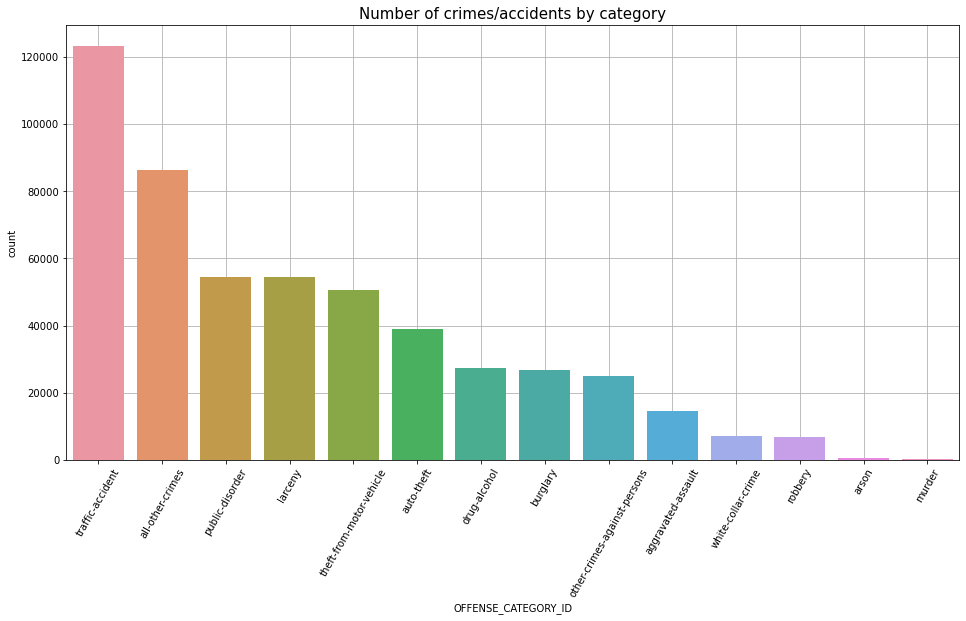

In [22]:
fig, ax = plt.subplots(figsize=(16,8))

sns.countplot(data=df, x='OFFENSE_CATEGORY_ID', order=df.OFFENSE_CATEGORY_ID.value_counts().index, ax=ax, zorder=3)

plt.title('Number of crimes/accidents by category', size=15)
plt.xticks(rotation=60)
ax.grid(zorder=3)

plt.show()

In [23]:
time_gap_category = []
records = []
for record in df.OFFENSE_CATEGORY_ID.unique():
    records.append(record)
    time_gap_category.append(df.time_gap[df['OFFENSE_CATEGORY_ID'] == record].mean())

In [24]:
dftd = pd.DataFrame()
dftd['records'] = records
dftd['time_gap_category'] = time_gap_category
dftd = dftd.sort_values(by=['time_gap_category'],ascending=False)

In [25]:
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning) 

fig = go.Figure(
        data=[
            go.Line(
            x= dftd.records,
            y= np.array([df.time_gap.mean()]*len(dftd)),
            name='Mean'),
            
            go.Bar(
            x= dftd.records,
            y= dftd.time_gap_category,
            name='Category'),
            ],
    layout=go.Layout(
        title={
            'text': 'Time differance between first occurence and reported date'
        })
)


fig.show()

/home/czeslaw/anaconda3/lib/python3.8/site-packages/plotly/graph_objs/_deprecations.py:378: DeprecationWarning: plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.

  warnings.warn(


In [26]:
#Grabing the data for visualizations
category = []
year = []
values = []
for record in df.OFFENSE_CATEGORY_ID.value_counts().index.tolist():
    for record2 in df.occurence_year.unique():
        category.append(record)
        year.append(record2)
        values.append(df.OFFENSE_CATEGORY_ID[(df['occurence_year'] == record2) & (df['OFFENSE_CATEGORY_ID'] == record)].value_counts().tolist()[0])

df_year_cat = pd.DataFrame()
df_year_cat['category'] = category
df_year_cat['values'] = values
df_year_cat['year'] = year

In [27]:
fig = px.line(data_frame=df_year_cat[df_year_cat['year'] != 2021].sort_values(by=['year']),
              x='year', y='values', color='category', log_y=True,
              title='Number of crimes / accidents in 2016-2020 ')


fig.show()

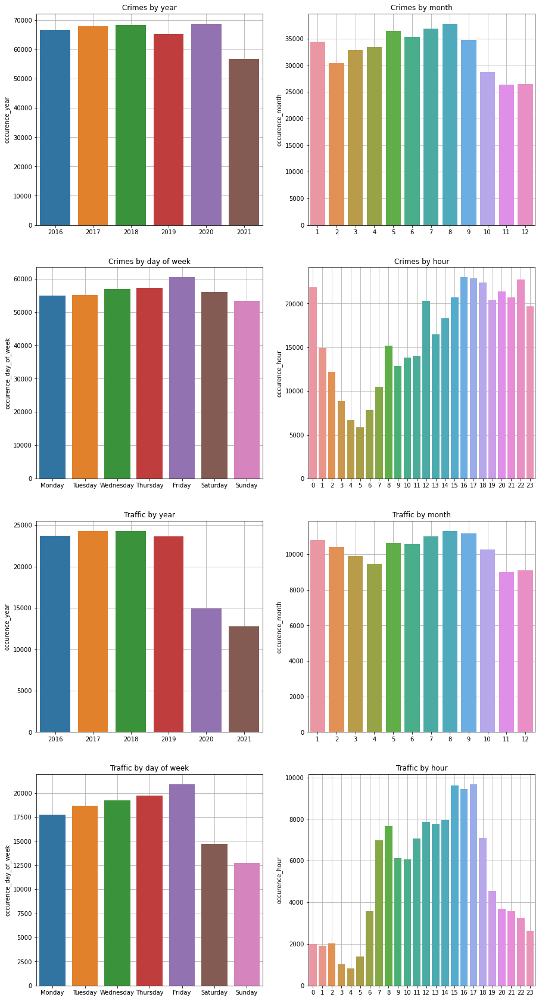

In [28]:
data1 = df.query('IS_CRIME == 1')
data2 = df.query('IS_TRAFFIC == 1')

fig, ax = plt.subplots(nrows=4,ncols=2, figsize=(15,30))

sns.barplot(x=data1.occurence_year.value_counts().index, y=data1.occurence_year.value_counts(), ax=ax[0,0],zorder=3)
sns.barplot(x=data1.occurence_month.value_counts().index,y=data1.occurence_month.value_counts(), ax=ax[0,1],zorder=3)

sns.barplot(x=data1.occurence_day_of_week.value_counts().index, y=data1.occurence_day_of_week.value_counts(), ax=ax[1,0],zorder=3)
sns.barplot(x=data1.occurence_hour.value_counts().index, y=data1.occurence_hour.value_counts(), ax=ax[1,1],zorder=3)

sns.barplot(x=data2.occurence_year.value_counts().index,y=data2.occurence_year.value_counts(), ax=ax[2,0],zorder=3)
sns.barplot(x=data2.occurence_month.value_counts().index,y=data2.occurence_month.value_counts(), ax=ax[2,1],zorder=3)

sns.barplot(x=data2.occurence_day_of_week.value_counts().index, y=data2.occurence_day_of_week.value_counts(), ax=ax[3,0],zorder=3)
sns.barplot(x=data2.occurence_hour.value_counts().index, y=data2.occurence_hour.value_counts(), ax=ax[3,1],zorder=3)

day_labels = ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday']

ax[0,0].grid(zorder=0)
ax[0,0].title.set_text('Crimes by year')
ax[0,1].grid(zorder=0)
ax[0,1].title.set_text('Crimes by month')

ax[1,0].grid(zorder=0)
ax[1,0].set_xticklabels(day_labels)
ax[1,0].title.set_text('Crimes by day of week')
ax[1,1].grid(zorder=0)
ax[1,1].title.set_text('Crimes by hour')

ax[2,0].grid(zorder=0)
ax[2,0].title.set_text('Traffic by year')
ax[2,1].grid(zorder=0)
ax[2,1].title.set_text('Traffic by month')

ax[3,0].grid(zorder=0)
ax[3,0].set_xticklabels(day_labels)
ax[3,0].title.set_text('Traffic by day of week')
ax[3,1].grid(zorder=0)
ax[3,1].title.set_text('Traffic by hour')

## Conclusions
### Most of crimes happen in disticts 3 and 6. The least crimes occur in district 7 (airport)
### The number of crimes outweighs the number of car accidents. Crimes account for over 350,000 records and accidents around 120,000.
### Top 5 categories by records are traffic-accident, all other crimes, larceny, public disorder and theft from motor vehicle. 
### Bottom of crimes are aggravated-assault, white collar crimes, robbery, arson and murder.
### The time differance between first occurence and reported date is the biggest for white collar crimes and it's over 25 days, while mean for all type of crimes is 2,72. The shortest time is for traffic accident, murder and drug-alcohol
### The trend of crimes/accidents is going down. The main impact on trend has a number of traffic accidents. The number of crimes are similar for every year. Numbers of traffic accidents has significantly decreased in 2020.
### Friday is a day when most of crimes and traffic accidents happen. 
### Number of crimes are similar for every day of week, while number of accidents decrease slightly on weekend.
### Crimes mostly take place in the afternoon and evening. After midnight, the number drops significantly. 

## 

## Specific categories:

## Arson

In [29]:
from scipy.stats import gaussian_kde

data1= df.query('OFFENSE_CATEGORY_ID == ["arson"]')

In [30]:
x_gaus = np.array(data1.GEO_LON)
y_gaus = np.array(data1.GEO_LAT)

xy = np.vstack([x_gaus,y_gaus])
z = gaussian_kde(xy)(xy)

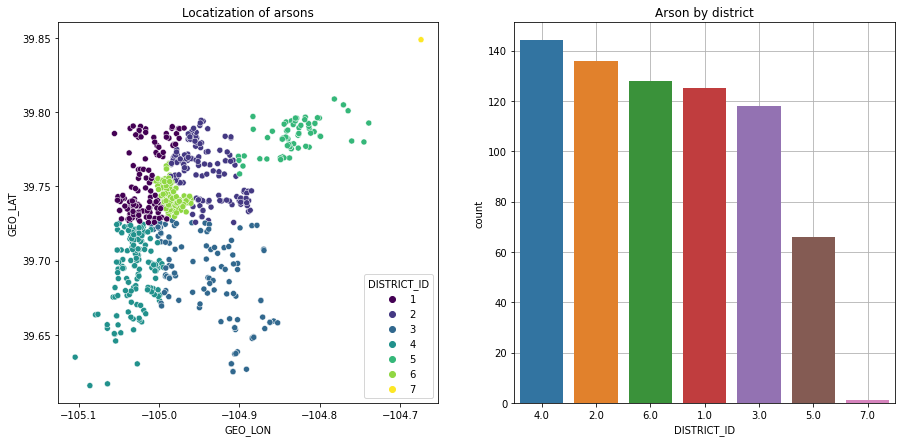

In [31]:
fig, ax = plt.subplots(nrows=1,ncols=2, figsize=(15,7))

sns.scatterplot(data=data1,x='GEO_LON', y='GEO_LAT',hue='DISTRICT_ID', palette='viridis',ax=ax[0])
sns.countplot(data=data1, x='DISTRICT_ID', order=data1.DISTRICT_ID.value_counts().index, ax=ax[1],zorder=3)

ax[0].title.set_text('Locatization of arsons')

ax[1].grid(zorder=3)
ax[1].title.set_text('Arson by district')

fig2 = px.density_mapbox(lat=y_gaus, lon=x_gaus, z=z, radius=30, 
                        center=go.layout.mapbox.Center(
                        lat=39.73224, lon=-104.986306),
                        opacity = 0.5, zoom=11.75)
fig2.update_layout(mapbox_style="stamen-toner",margin=dict(b=0, t=0, l=40, r=0))


plt.show()
fig2.show()

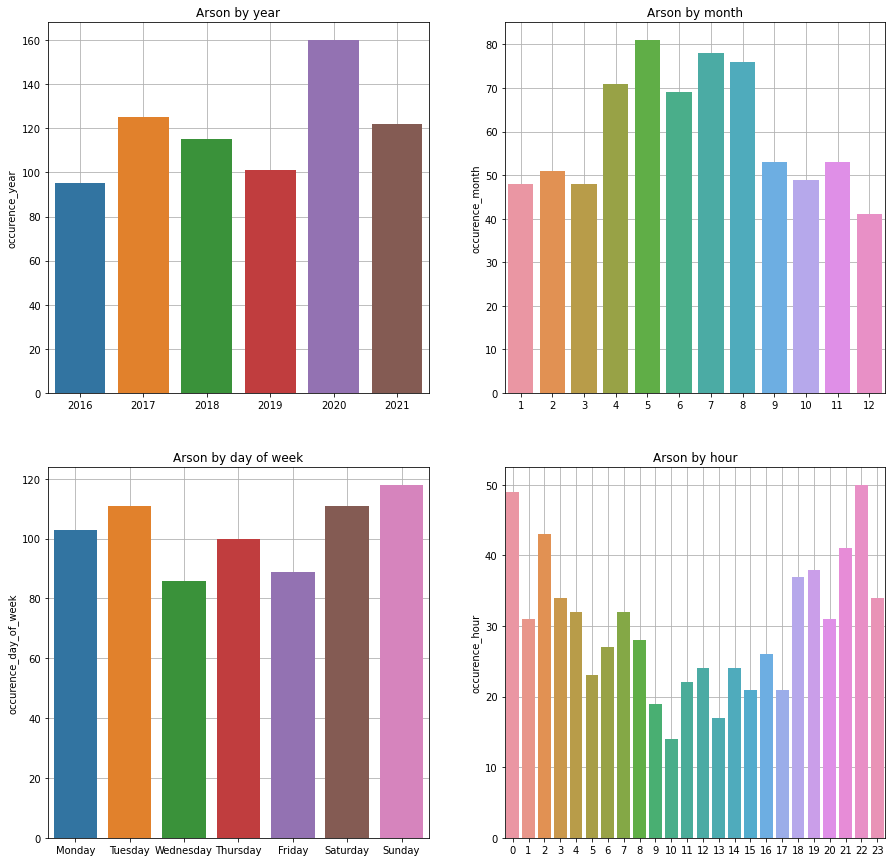

In [32]:
fig, ax = plt.subplots(nrows=2,ncols=2, figsize=(15,15))

sns.barplot(x=data1.occurence_year.value_counts().index, y=data1.occurence_year.value_counts(), ax=ax[0,0],zorder=3)
sns.barplot(x=data1.occurence_month.value_counts().index,y=data1.occurence_month.value_counts(), ax=ax[0,1],zorder=3)

sns.barplot(x=data1.occurence_day_of_week.value_counts().index, y=data1.occurence_day_of_week.value_counts(), ax=ax[1,0],zorder=3)
sns.barplot(x=data1.occurence_hour.value_counts().index, y=data1.occurence_hour.value_counts(), ax=ax[1,1],zorder=3)

ax[0,0].grid(zorder=0)
ax[0,0].title.set_text('Arson by year')
ax[0,1].grid(zorder=0)
ax[0,1].title.set_text('Arson by month')

ax[1,0].grid(zorder=0)
ax[1,0].set_xticklabels(day_labels)
ax[1,0].title.set_text('Arson by day of week')
ax[1,1].grid(zorder=0)
ax[1,1].title.set_text('Arson by hour')

## Conclusions
### District with the heighst number of arsons is district nr 4.
### A significant part of arsons occur in the late evening and at night
### Arsons were going down from 2017 to 2019. In 2020, they increased from 100 records to almost 160

## Drug crimes

In [33]:
data1 = df.query('OFFENSE_CATEGORY_ID == ["drug-alcohol"]')

In [34]:
x_gaus = np.array(data1.GEO_LON)
y_gaus = np.array(data1.GEO_LAT)

xy = np.vstack([x_gaus,y_gaus])
z = gaussian_kde(xy)(xy)

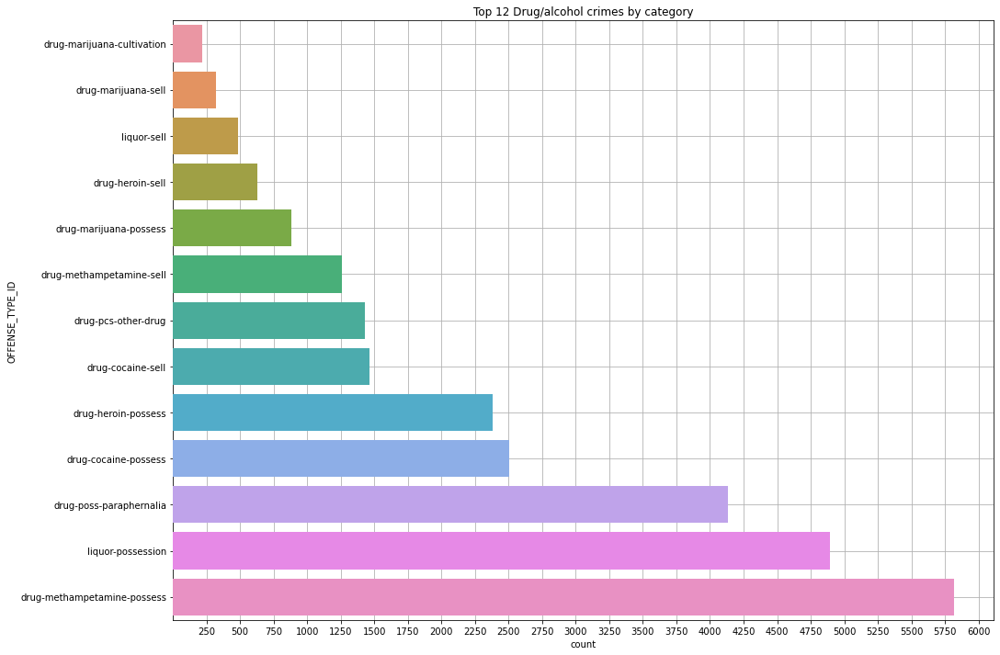

In [35]:
fig, ax = plt.subplots(figsize=(16,12))
labels = np.arange(250,6001,250)

sns.countplot(data=data1, y='OFFENSE_TYPE_ID', 
              order=data1.OFFENSE_TYPE_ID.value_counts().sort_values(ascending=True)[(data1.OFFENSE_TYPE_ID.value_counts() >= 200)].index,
              zorder=3)

plt.title('Top 12 Drug/alcohol crimes by category')
plt.xticks(labels)

ax.grid(zorder=4)

plt.show()

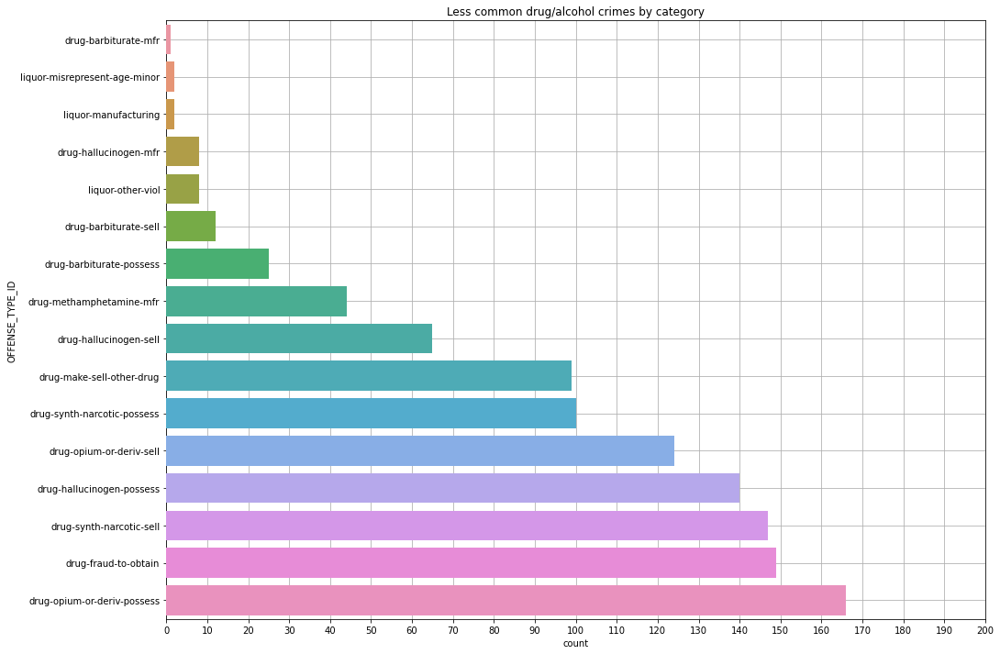

In [36]:
fig, ax = plt.subplots(figsize=(16,12))
labels = np.arange(0,201,10)

sns.countplot(data=data1, y='OFFENSE_TYPE_ID', 
              order=data1.OFFENSE_TYPE_ID.value_counts().sort_values(ascending=True)[(data1.OFFENSE_TYPE_ID.value_counts() < 200)].index,
              zorder=3)

plt.title('Less common drug/alcohol crimes by category')
plt.xticks(labels)

ax.grid(zorder=4)

plt.show()

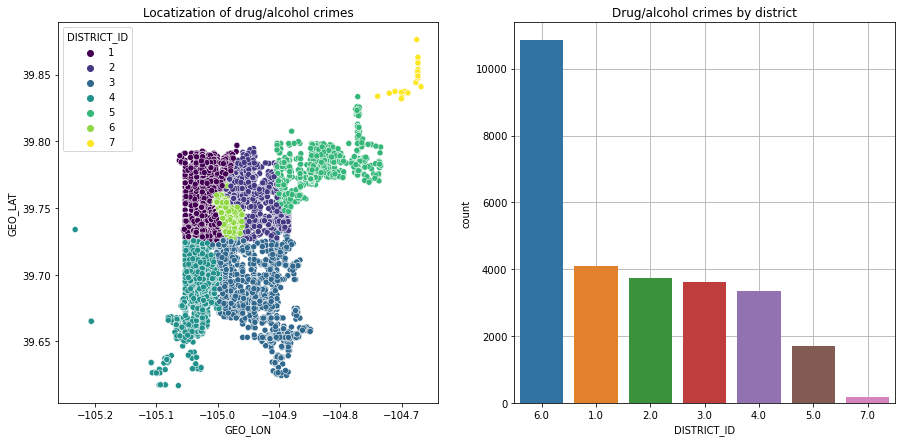

In [37]:
fig, ax = plt.subplots(nrows=1,ncols=2, figsize=(15,7))

sns.scatterplot(data=data1,x='GEO_LON', y='GEO_LAT',hue='DISTRICT_ID', palette='viridis',ax=ax[0])
sns.countplot(data=data1, x='DISTRICT_ID', order=data1.DISTRICT_ID.value_counts().index, ax=ax[1],zorder=3)

ax[0].title.set_text('Locatization of drug/alcohol crimes')

ax[1].grid(zorder=3)
ax[1].title.set_text('Drug/alcohol crimes by district')

fig2 = px.density_mapbox(lat=y_gaus, lon=x_gaus, z=z, radius=30, 
                        center=go.layout.mapbox.Center(
                        lat=39.73224, lon=-104.986306),
                        opacity = 0.5, zoom=11.75)

fig2.update_layout(mapbox_style="stamen-toner")
fig2.update_layout(margin=dict(b=0, t=0, l=40, r=0))


plt.show()
fig2.show()

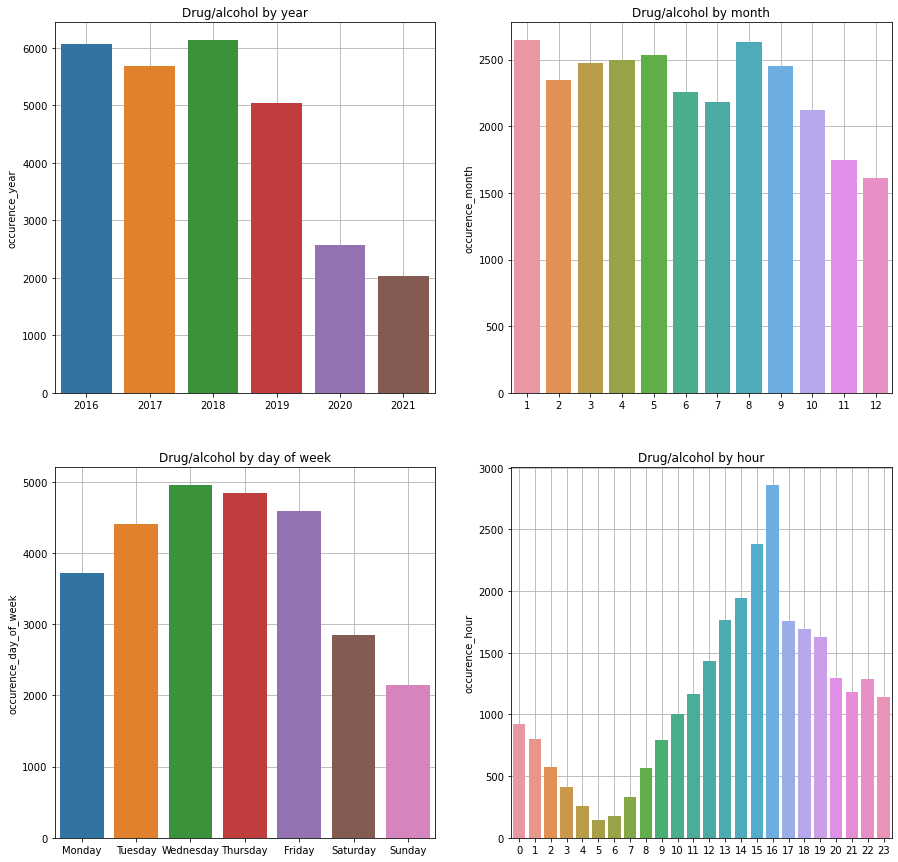

In [38]:
fig, ax = plt.subplots(nrows=2,ncols=2, figsize=(15,15))

sns.barplot(x=data1.occurence_year.value_counts().index, y=data1.occurence_year.value_counts(), ax=ax[0,0],zorder=3)
sns.barplot(x=data1.occurence_month.value_counts().index,y=data1.occurence_month.value_counts(), ax=ax[0,1],zorder=3)

sns.barplot(x=data1.occurence_day_of_week.value_counts().index, y=data1.occurence_day_of_week.value_counts(), ax=ax[1,0],zorder=3)
sns.barplot(x=data1.occurence_hour.value_counts().index, y=data1.occurence_hour.value_counts(), ax=ax[1,1],zorder=3)

ax[0,0].grid(zorder=0)
ax[0,0].title.set_text('Drug/alcohol by year')
ax[0,1].grid(zorder=0)
ax[0,1].title.set_text('Drug/alcohol by month')

ax[1,0].grid(zorder=0)
ax[1,0].set_xticklabels(day_labels)
ax[1,0].title.set_text('Drug/alcohol by day of week')
ax[1,1].grid(zorder=0)
ax[1,1].title.set_text('Drug/alcohol by hour')

## Conclusions
### District with the heighst number of drug/alcohol crimes is district nr 6.
### A significant part of drug/alcohol crimes occur in the afternoon and evening.
### There was  a huge drop in drug/alcohol crimes in 2020 compared to previous years.
### A day with the biggest number of alcohol/drug cases are Wednesday. 

## White Collar Crimes

In [39]:
data1 = df.query('OFFENSE_CATEGORY_ID == ["white-collar-crime"]')

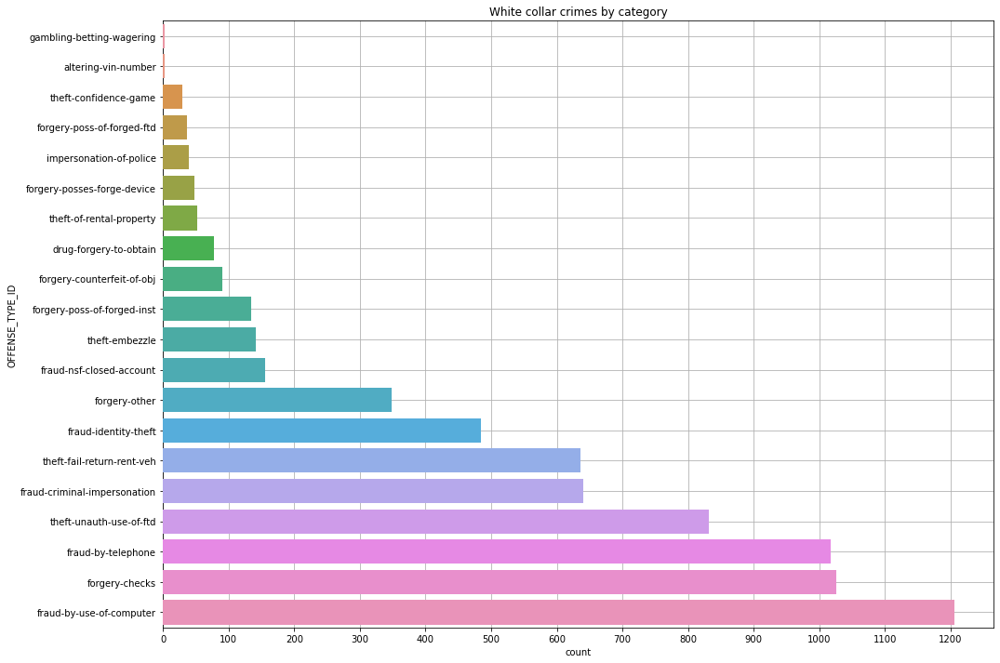

In [40]:
fig, ax = plt.subplots(figsize=(16,12))
labels = np.arange(0,1250,100)

sns.countplot(data=data1, y='OFFENSE_TYPE_ID', order=data1.OFFENSE_TYPE_ID.value_counts(ascending=True).index, zorder=3)

plt.title('White collar crimes by category')
plt.xticks(labels)

ax.grid(zorder=4)

plt.show()

In [41]:
x_gaus = np.array(data1.GEO_LON)
y_gaus = np.array(data1.GEO_LAT)

xy = np.vstack([x_gaus,y_gaus])
z = gaussian_kde(xy)(xy)

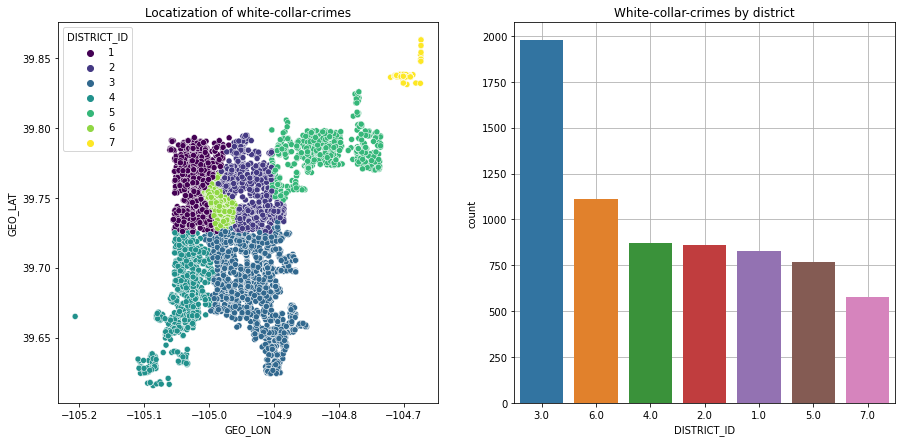

In [42]:
fig, ax = plt.subplots(nrows=1,ncols=2, figsize=(15,7))

sns.scatterplot(data=data1,x='GEO_LON', y='GEO_LAT',hue='DISTRICT_ID', palette='viridis',ax=ax[0])
sns.countplot(data=data1, x='DISTRICT_ID', order=data1.DISTRICT_ID.value_counts().index, ax=ax[1],zorder=3)

ax[0].title.set_text('Locatization of white-collar-crimes')

ax[1].grid(zorder=3)
ax[1].title.set_text('White-collar-crimes by district')

fig2 = px.density_mapbox(lat=y_gaus, lon=x_gaus, z=z, radius=30, 
                        center=go.layout.mapbox.Center(
                        lat=39.73224, lon=-104.986306),
                        opacity = 0.5, zoom=11.75)

fig2.update_layout(mapbox_style="stamen-toner")
fig2.update_layout(margin=dict(b=0, t=0, l=40, r=0))


plt.show()
fig2.show()

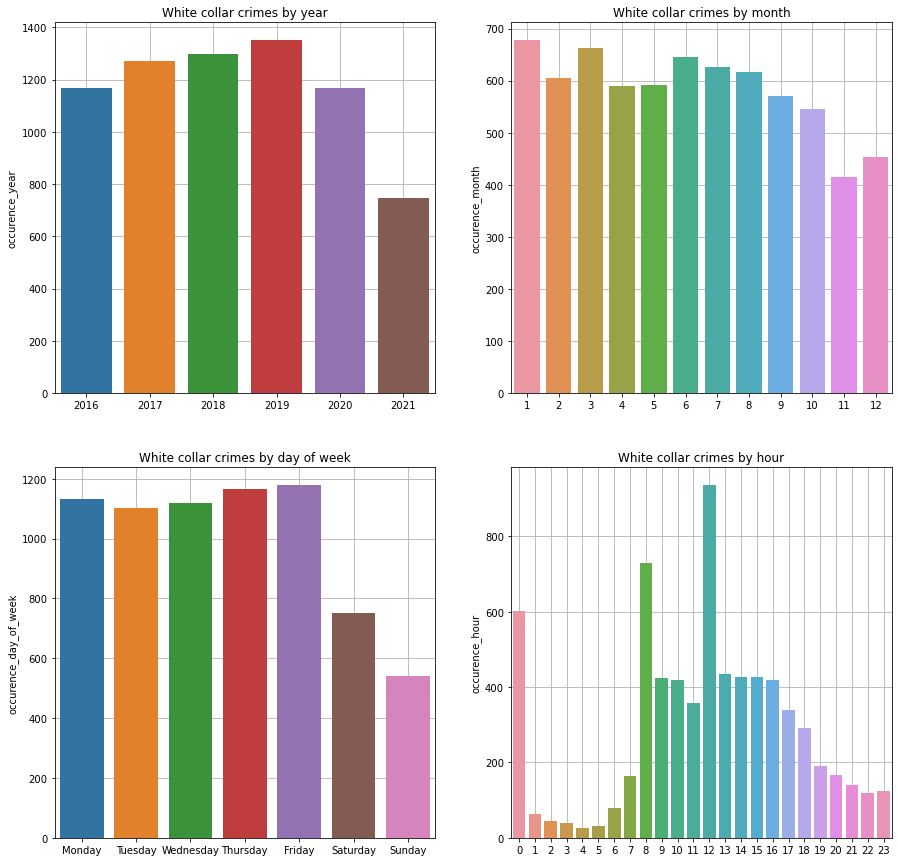

In [43]:
fig, ax = plt.subplots(nrows=2,ncols=2, figsize=(15,15))

sns.barplot(x=data1.occurence_year.value_counts().index, y=data1.occurence_year.value_counts(), ax=ax[0,0],zorder=3)
sns.barplot(x=data1.occurence_month.value_counts().index,y=data1.occurence_month.value_counts(), ax=ax[0,1],zorder=3)

sns.barplot(x=data1.occurence_day_of_week.value_counts().index, y=data1.occurence_day_of_week.value_counts(), ax=ax[1,0],zorder=3)
sns.barplot(x=data1.occurence_hour.value_counts().index, y=data1.occurence_hour.value_counts(), ax=ax[1,1],zorder=3)

ax[0,0].grid(zorder=0)
ax[0,0].title.set_text('White collar crimes by year')
ax[0,1].grid(zorder=0)
ax[0,1].title.set_text('White collar crimes by month')

ax[1,0].grid(zorder=0)
ax[1,0].set_xticklabels(day_labels)
ax[1,0].title.set_text('White collar crimes by day of week')
ax[1,1].grid(zorder=0)
ax[1,1].title.set_text('White collar crimes by hour')

## Conclusions
### District with the heighst number of white collar crimes is district nr 3.
### A significant part of  white collar crimes occur in the morning and afternoon, especially at 8 am and 12 pm. 
### The number of cases went down in 2020.
### A day with the biggest number of white collar crimes is Friday. It's decreasing on the weekend. 
### Frauds by computer and telephone and forgery checks are main categories of white collar crimes.

## All-other-crimes

In [44]:
data1 = df.query('OFFENSE_CATEGORY_ID == ["all-other-crimes"]')

In [45]:
top10 = pd.DataFrame(data1.OFFENSE_TYPE_ID.value_counts()[:10])
top10 = top10.reset_index()

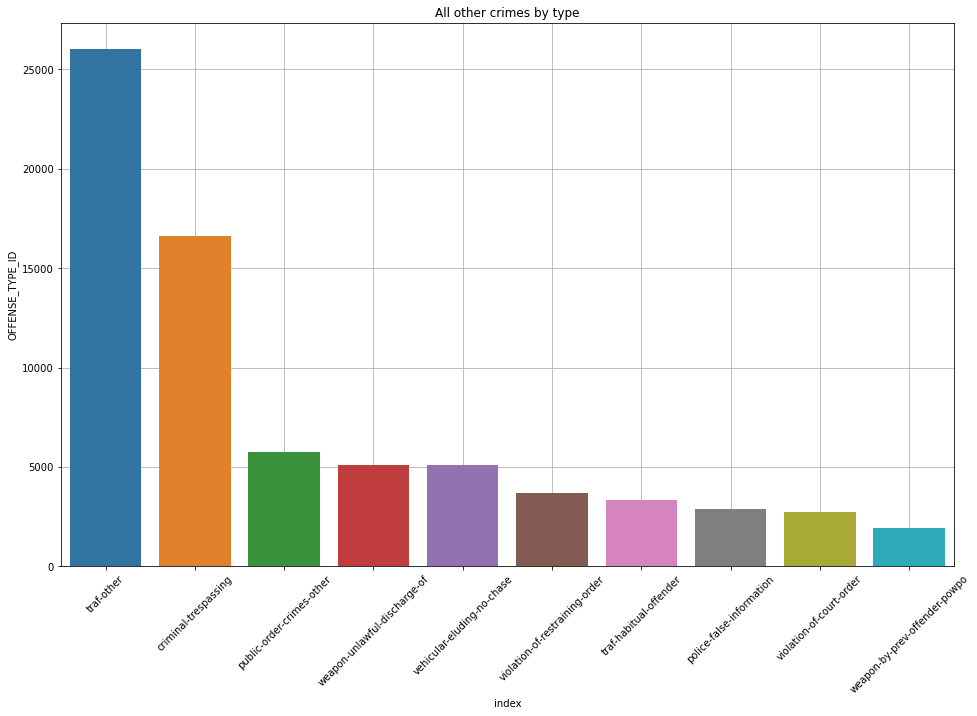

In [46]:
fig, ax = plt.subplots(figsize=(16,10))

sns.barplot(data=top10,x='index',y='OFFENSE_TYPE_ID', zorder=3,ax=ax)

plt.title('All other crimes by type')

ax.grid(zorder=4)
plt.xticks(rotation=45)

plt.show()

In [47]:
x_gaus = np.array(data1.GEO_LON)
y_gaus = np.array(data1.GEO_LAT)

xy = np.vstack([x_gaus,y_gaus])
z = gaussian_kde(xy)(xy)

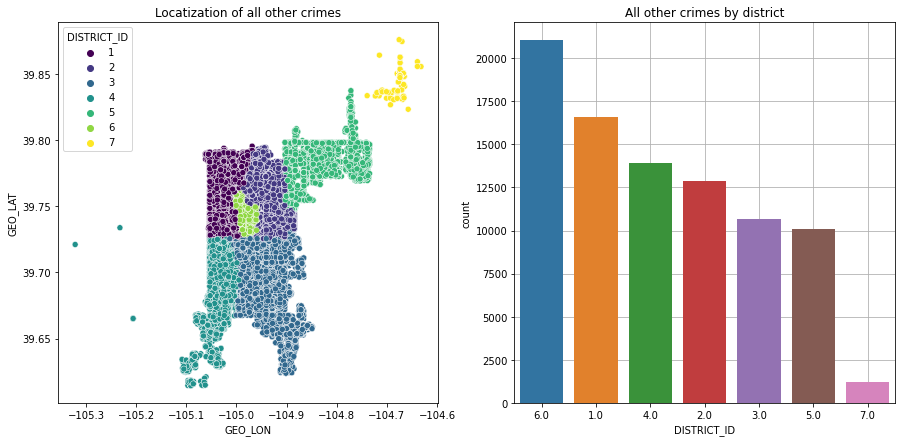

In [48]:
fig, ax = plt.subplots(nrows=1,ncols=2, figsize=(15,7))

sns.scatterplot(data=data1,x='GEO_LON', y='GEO_LAT',hue='DISTRICT_ID', palette='viridis',ax=ax[0])
sns.countplot(data=data1, x='DISTRICT_ID', order=data1.DISTRICT_ID.value_counts().index, ax=ax[1],zorder=3)

ax[0].title.set_text('Locatization of all other crimes')

ax[1].grid(zorder=3)
ax[1].title.set_text('All other crimes by district')

fig2 = px.density_mapbox(lat=y_gaus, lon=x_gaus, z=z, radius=30, 
                        center=go.layout.mapbox.Center(
                        lat=39.73224, lon=-104.986306),
                        opacity = 0.5, zoom=11.75)

fig2.update_layout(mapbox_style="stamen-toner")
fig2.update_layout(margin=dict(b=0, t=0, l=40, r=0))


plt.show()
fig2.show()

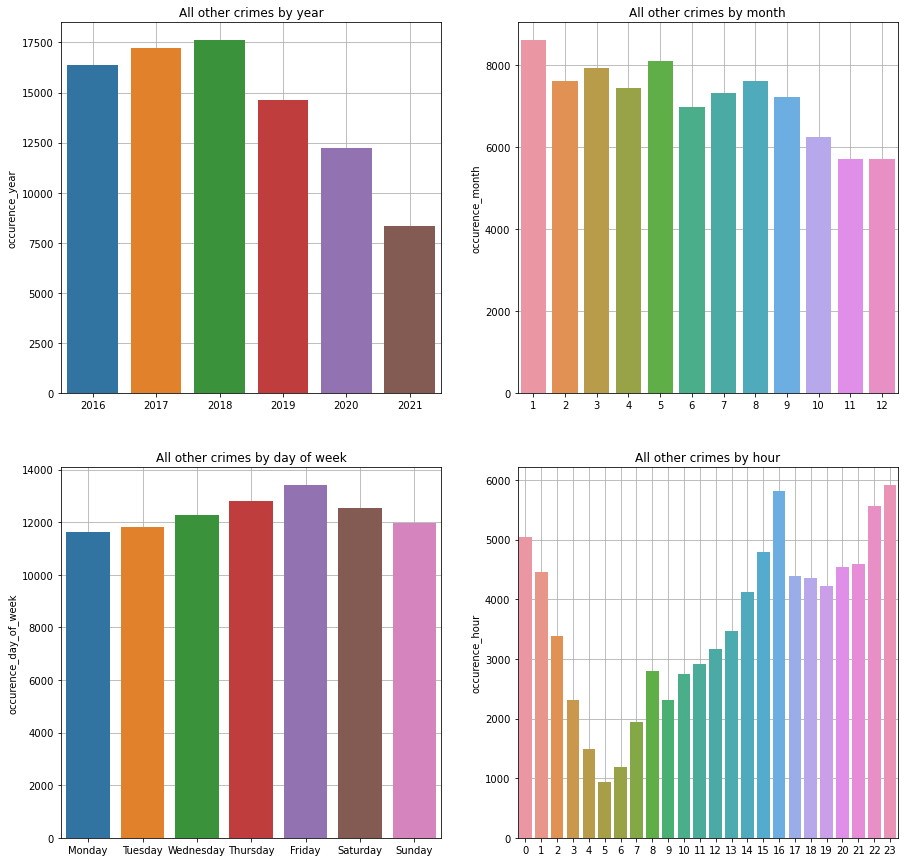

In [49]:
fig, ax = plt.subplots(nrows=2,ncols=2, figsize=(15,15))

sns.barplot(x=data1.occurence_year.value_counts().index, y=data1.occurence_year.value_counts(), ax=ax[0,0],zorder=3)
sns.barplot(x=data1.occurence_month.value_counts().index,y=data1.occurence_month.value_counts(), ax=ax[0,1],zorder=3)

sns.barplot(x=data1.occurence_day_of_week.value_counts().index, y=data1.occurence_day_of_week.value_counts(), ax=ax[1,0],zorder=3)
sns.barplot(x=data1.occurence_hour.value_counts().index, y=data1.occurence_hour.value_counts(), ax=ax[1,1],zorder=3)

ax[0,0].grid(zorder=0)
ax[0,0].title.set_text('All other crimes by year')
ax[0,1].grid(zorder=0)
ax[0,1].title.set_text('All other crimes by month')

ax[1,0].grid(zorder=0)
ax[1,0].set_xticklabels(day_labels)
ax[1,0].title.set_text('All other crimes by day of week')
ax[1,1].grid(zorder=0)
ax[1,1].title.set_text('All other crimes by hour')

### Most of cases occur in evening hours and around midnight
### The number of other crimes are going down
### Other traffic and Criminal tresspasing cases are the main categories

## Larceny

In [50]:
data1 = df.query('OFFENSE_CATEGORY_ID == ["larceny"]')

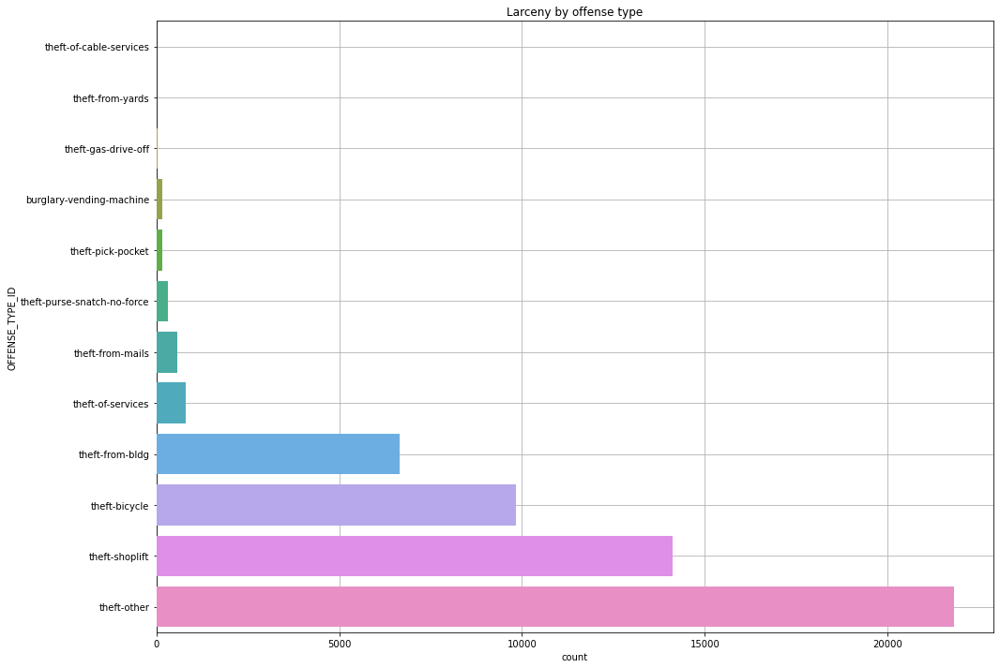

In [51]:
fig, ax = plt.subplots(figsize=(16,12))

sns.countplot(data=data1, y='OFFENSE_TYPE_ID', order=data1.OFFENSE_TYPE_ID.value_counts(ascending=True).index, zorder=3)

plt.title('Larceny by offense type')
ax.grid(zorder=4)

plt.show()

In [52]:
x_gaus = np.array(data1.GEO_LON)
y_gaus = np.array(data1.GEO_LAT)

xy = np.vstack([x_gaus,y_gaus])
z = gaussian_kde(xy)(xy)

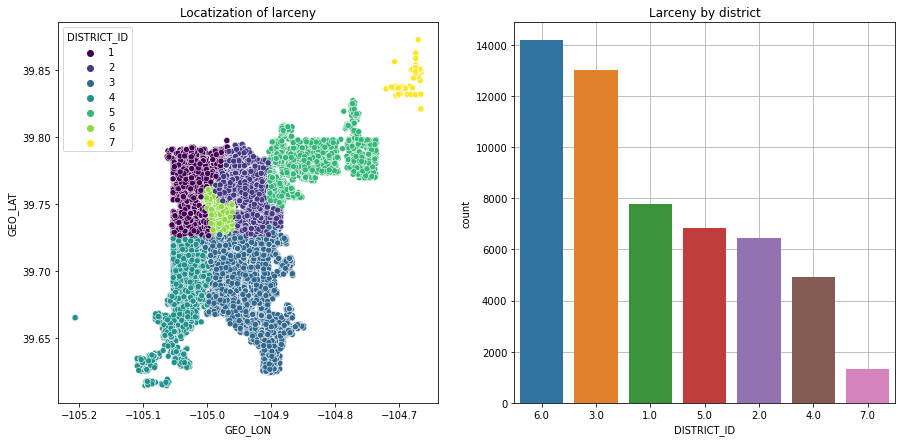

In [53]:
fig, ax = plt.subplots(nrows=1,ncols=2, figsize=(15,7))

sns.scatterplot(data=data1,x='GEO_LON', y='GEO_LAT',hue='DISTRICT_ID', palette='viridis',ax=ax[0])
sns.countplot(data=data1, x='DISTRICT_ID', order=data1.DISTRICT_ID.value_counts().index, ax=ax[1],zorder=3)

ax[0].title.set_text('Locatization of larceny')

ax[1].grid(zorder=3)
ax[1].title.set_text('Larceny by district')

fig2 = px.density_mapbox(lat=y_gaus, lon=x_gaus, z=z, radius=30, 
                        center=go.layout.mapbox.Center(
                        lat=39.73224, lon=-104.986306),
                        opacity = 0.5, zoom=11.75)

fig2.update_layout(mapbox_style="stamen-toner")
fig2.update_layout(margin=dict(b=0, t=0, l=40, r=0))


plt.show()
fig2.show()

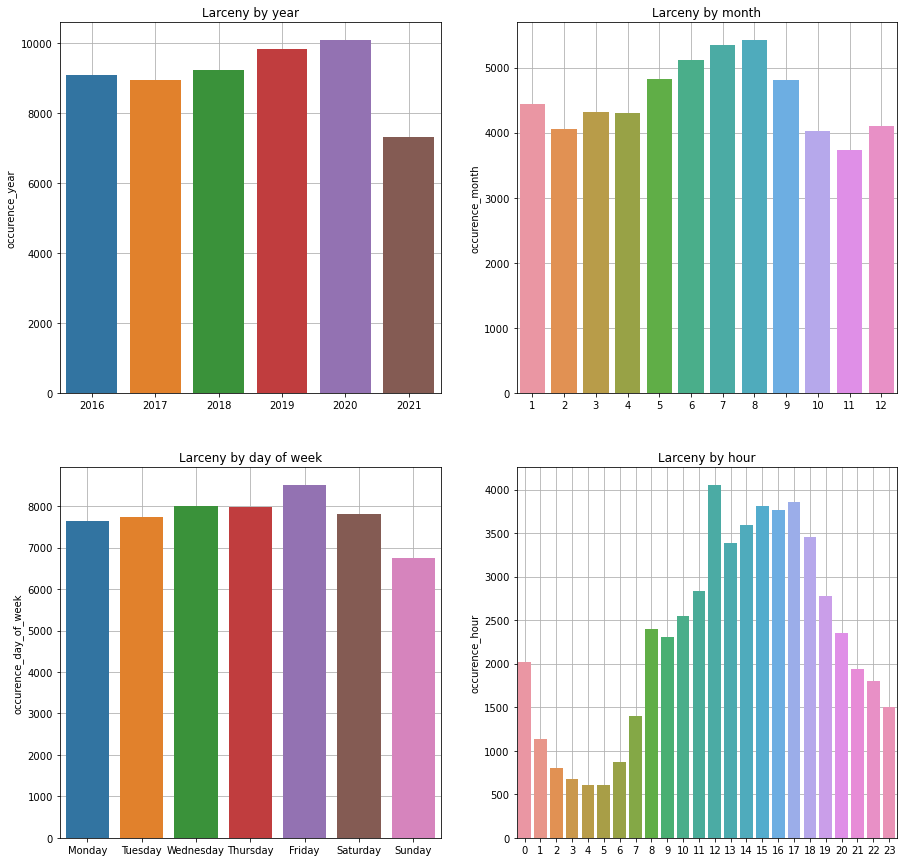

In [54]:
fig, ax = plt.subplots(nrows=2,ncols=2, figsize=(15,15))

sns.barplot(x=data1.occurence_year.value_counts().index, y=data1.occurence_year.value_counts(), ax=ax[0,0],zorder=3)
sns.barplot(x=data1.occurence_month.value_counts().index,y=data1.occurence_month.value_counts(), ax=ax[0,1],zorder=3)

sns.barplot(x=data1.occurence_day_of_week.value_counts().index, y=data1.occurence_day_of_week.value_counts(), ax=ax[1,0],zorder=3)
sns.barplot(x=data1.occurence_hour.value_counts().index, y=data1.occurence_hour.value_counts(), ax=ax[1,1],zorder=3)

ax[0,0].grid(zorder=0)
ax[0,0].title.set_text('Larceny by year')
ax[0,1].grid(zorder=0)
ax[0,1].title.set_text('Larceny by month')

ax[1,0].grid(zorder=0)
ax[1,0].set_xticklabels(day_labels)
ax[1,0].title.set_text('Larceny by day of week')
ax[1,1].grid(zorder=0)
ax[1,1].title.set_text('Larceny by hour')

## Conclusions
### The number of larceny is rising year by year.
### A significant part of  larceny occur from afternoon until evening.
### Most of cases consist from 3 type offenses: theft-other, theft-shoplift, theft-bicycle